In [1]:
import os
import cv2
import shutil
import pickle
import numpy as np
from tqdm import tqdm
from random import sample
from ultralytics import YOLO
import matplotlib.pyplot as plt
from keras.layers import Flatten
from sklearn.metrics.pairwise import cosine_similarity
from keras.applications.vgg19 import VGG19, preprocess_input

In [2]:
if not os.path.exists('./shop'):
    os.mkdir('./shop')

    path = os.path.join(os.getcwd(), 'images')
    genders = os.listdir(path)
    for gender in genders:
        items = os.listdir(os.path.join(path, gender))
        for item in items:
            ids = os.listdir(os.path.join(path, gender, item))
            for id in ids:
                image_path = os.path.join(path, gender, item, id)
                images = os.listdir(image_path)
                images.sort()
                
                if len(images)==0: continue
                
                new_path = os.path.join(os.getcwd(), 'shop', gender, item)
                os.makedirs(new_path, exist_ok=True)
                
                shutil.copy(os.path.join(image_path, images[0]), os.path.join(new_path, f'{id} {images[0]}'))

In [3]:
model_pretrained = VGG19(input_shape=(256, 256, 3),
                         include_top=False,
                         weights='imagenet')


def feature_extractor(x, actual_file=False):
    if not actual_file:
        x = cv2.imread(x)
        if x is None or x.size == 0:
            raise ValueError("Invalid image file or empty image")
        # x = cv2.cvtColor(x, cv2.COLOR_BGR2RGB)  # uncomment this line if needed
        x = cv2.resize(x, (256, 256), interpolation=cv2.INTER_AREA)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = model_pretrained.predict(x)
    return Flatten()(features).numpy()

80134624/80134624 [==============================] - 15s 0us/step


In [5]:
classes = ['top',
           'top',
           'outwear',
           'outwear',
           'vest',
           'vest',
           'shorts',
           'trousers',
           'skirts',
           'dress',
           'dress',
           'dress',
           'dress']

model = YOLO('./runs/detect/train/weights/best.pt')

def predict(frame):
    frame = cv2.imread(frame)
    result = {}

    results = model.predict(frame, conf=0.4)
    labels = results[0].boxes.cls.tolist()
    boxes = results[0].boxes.data.tolist()

    if len(labels) == 0:
        print("No object detected. Please try another image!")
        return

    for i in range(0, len(labels)):
        label = classes[int(labels[i])]
        left, top, width, height, _, _ = boxes[i]
        left = int(left)
        top = int(top)
        width = int(width)
        height = int(height)
        resize = frame[top:top+height, left:left+width, :]
        resize = cv2.resize(resize, (256, 256), interpolation=cv2.INTER_AREA)
        result[label] = feature_extractor(resize, actual_file=True)

    return result

In [6]:
categories = {
    'top': ['MEN/Shirts_Polos', 'MEN/Tees_Tanks', 'MEN/Sweaters', 'WOMEN/Blouses_Shirts', 'WOMEN/Graphic_Tees', 'WOMEN/Sweaters', 'WOMEN/Tees_Tanks'],
    'outwear': ['MEN/Sweatshirts_Hoodies', 'WOMEN/Cardigans', 'WOMEN/Jackets_Coats', 'WOMEN/Sweaters', 'WOMEN/Sweatshirts_Hoodies'],
    'vest': ['MEN/Jacket_Vests', 'WOMEN/Dresses', 'WOMEN/Jackets_Coats'],
    'shorts': ['MEN/Shorts', 'WOMEN/Shorts'],
    'trousers': ['MEN/Denim', 'MEN/Pants', 'WOMEN/Denim', 'WOMEN/Leggings', 'WOMEN/Pants'],
    'skirts': ['WOMEN/Skirts'],
    'dress': ['WOMEN/Dresses', 'WOMEN/Rompers_Jumpsuits'],
}

In [7]:
if not os.path.exists('./vector_images'):
    os.mkdir('./vector_images')

    path = os.path.join(os.getcwd(), 'shop')
    genders = os.listdir(path)
    for gender in genders:
        items = os.listdir(os.path.join(path, gender))
        for item in items:
            features = []
            order = []
            images = os.listdir(os.path.join(path, gender, item))
            for image in images:
                image_path = os.path.join(path, gender, item, image)
                feature = feature_extractor(str(image_path))
                features.append(feature)
                order.append(os.path.join(gender, item, image.split()[0]))
            
            os.makedirs(os.path.join(os.getcwd(), 'vector_images', gender, item), exist_ok=True)

            with open(os.path.join(os.getcwd(), 'vector_images', gender, item, f'{item}.npy'), 'wb') as f:
                np.save(f,np.array(features))
            with open(os.path.join(os.getcwd(), 'vector_images', gender, item, f'{item}.txt'), "wb") as fp:
                pickle.dump(order, fp)

1/1 [==============================] - 0s 144ms/step


1/1 [==============================] - 0s 142ms/step


1/1 [==============================] - 0s 157ms/step


1/1 [==============================] - 0s 156ms/step


1/1 [==============================] - 0s 153ms/step


1/1 [==============================] - 0s 164ms/step


1/1 [==============================] - 0s 153ms/step


1/1 [==============================] - 0s 161ms/step


1/1 [==============================] - 0s 166ms/step


1/1 [==============================] - 0s 177ms/step


1/1 [==============================] - 0s 187ms/step


1/1 [==============================] - 0s 242ms/step


1/1 [==============================] - 0s 399ms/step


1/1 [==============================] - 0s 484ms/step


1/1 [==============================] - 0s 464ms/step


1/1 [==============================] - 0s 453ms/step


1/1 [==============================] - 0s 465ms/step


1/1 [==============================] - 0s 455ms/step


1/1 [==============================] - 1s 500ms/step


1/1 [==============================] - 1s 516ms/step


1/1 [==============================] - 1s 582ms/step


1/1 [==============================] - 1s 597ms/step


1/1 [==============================] - 1s 611ms/step


1/1 [==============================] - 1s 628ms/step


1/1 [==============================] - 1s 626ms/step


1/1 [==============================] - 1s 643ms/step


1/1 [==============================] - 1s 647ms/step


1/1 [==============================] - 1s 672ms/step


1/1 [==============================] - 1s 695ms/step


1/1 [==============================] - 1s 735ms/step


1/1 [==============================] - 1s 822ms/step


1/1 [==============================] - 1s 848ms/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 1s 1s/step


1/1 [==============================] - 2s 2s/step


1/1 [==============================] - 2s 2s/step


1/1 [==============================] - 2s 2s/step


1/1 [==============================] - 2s 2s/step


In [8]:
def recommender(result, no_of_rec):
    match = {}

    for category, feature in result.items():
        similarity_score = []
        target = []
        feature = np.array(feature).reshape(1, -1)

        for shop_item in categories[category]:
            vector_path = os.path.join(os.getcwd(), 'vector_images', shop_item)
            with open(os.path.join(vector_path, f'{shop_item.split("/")[-1]}.npy'), 'rb') as f:
                shop_item_features = np.load(f)
            with open(os.path.join(vector_path, f'{shop_item.split("/")[-1]}.txt'), 'rb') as fp:
                saved_txt = pickle.load(fp)

            similarity_score.extend(cosine_similarity(lists, feature)[0][0] for lists in shop_item_features)
            target.extend(saved_txt)

        similarity_score = np.array(similarity_score)
        target = np.array(target).reshape(-1)

        match[category] = target[np.argsort(similarity_score)[::-1][:no_of_rec]]

    return match

In [9]:
def show_recommendation(match):
    for classname, images in match.items():
        for i, image in enumerate(images):
            print(f'\nArticle - {i+1}')
            shop_images = os.listdir(os.path.join(os.getcwd(), 'images', image))
            plt.figure(figsize=(20, 10))

            for j, img in enumerate(shop_images[:4]):
                plt.subplot(int(float('14'+str(j+1))))
                plt.axis('off')
                plt.title(img.split('_')[-1][:-4].title())
                plt.imshow(cv2.cvtColor(cv2.imread(os.path.join(os.getcwd(), 'images', image, img)), cv2.COLOR_BGR2RGB))

            plt.show()

In [10]:
# Remove all segment images from shop images
path = os.path.join(os.getcwd(), 'images')
genders = os.listdir(path)
for gender in genders:
    items = os.listdir(os.path.join(path, gender))
    for item in items:
        ids = os.listdir(os.path.join(path, gender, item))
        for id in ids:
            image_path = os.path.join(path, gender, item, id)
            images = os.listdir(image_path)
            for image in images:
                if 'segment' in image:
                    os.remove(os.path.join(image_path, image))


0: 640x448 1 long sleeve outwear, 1 trousers, 76.8ms
Speed: 5.0ms preprocess, 76.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 152ms/step


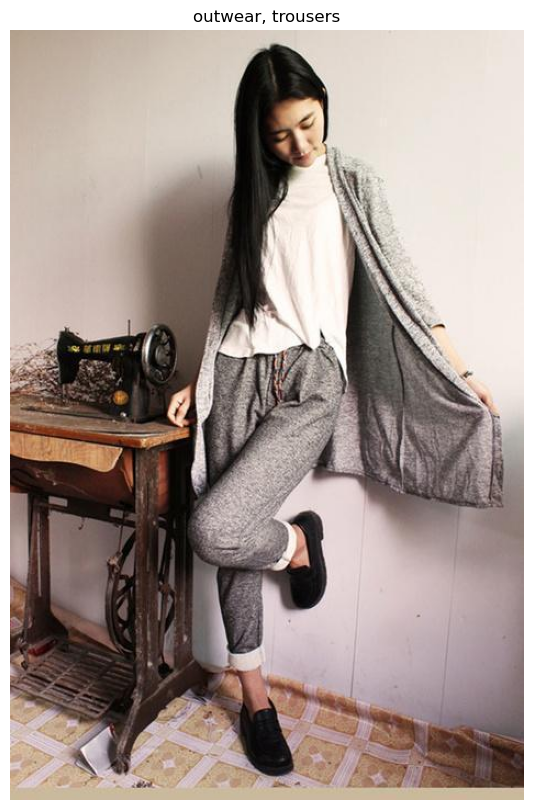


Article - 1


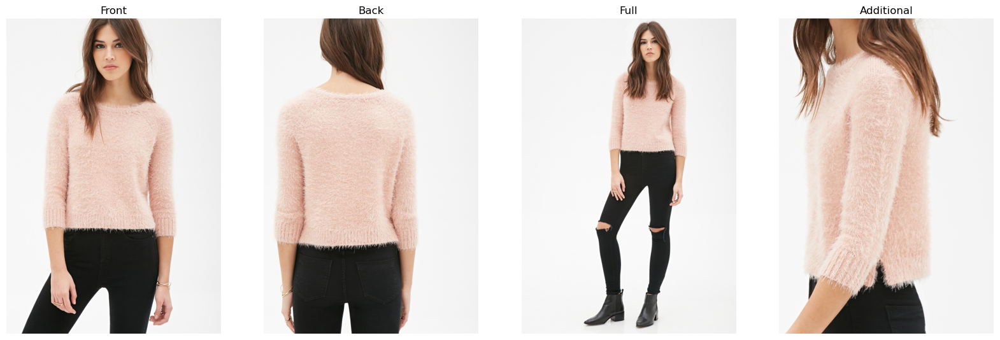


Article - 2


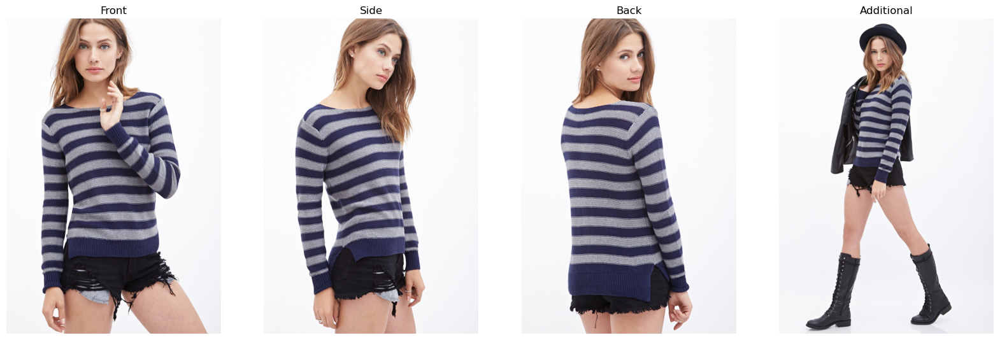


Article - 3


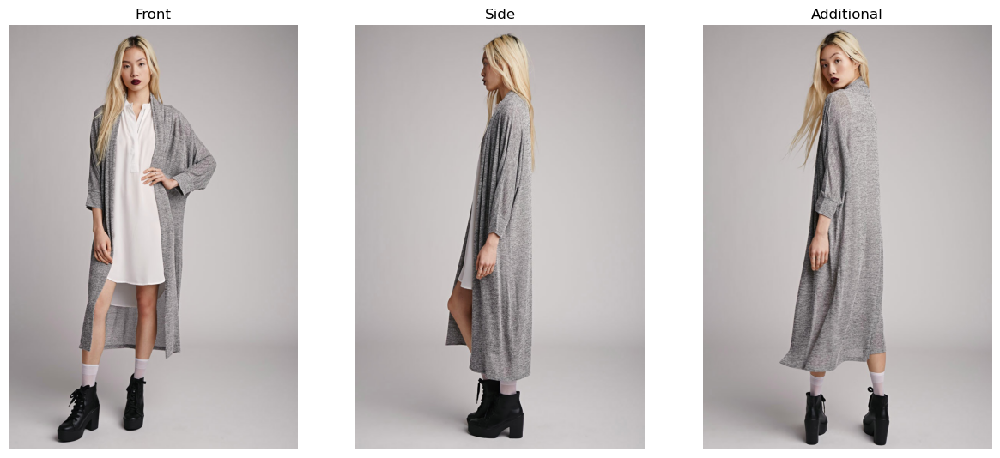


Article - 1


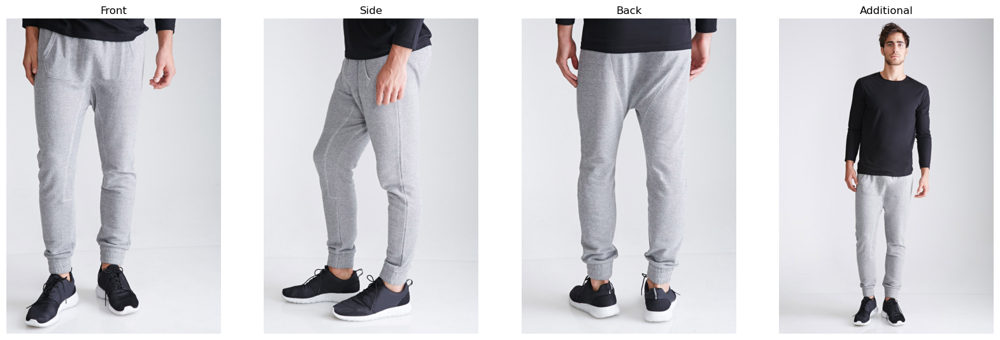


Article - 2


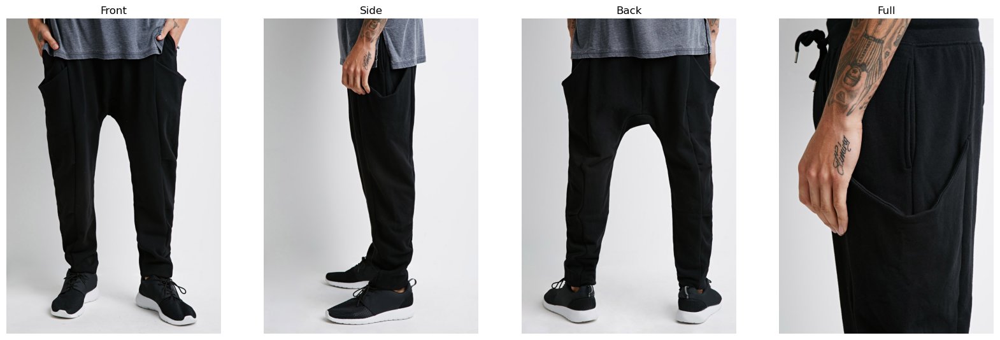


Article - 3


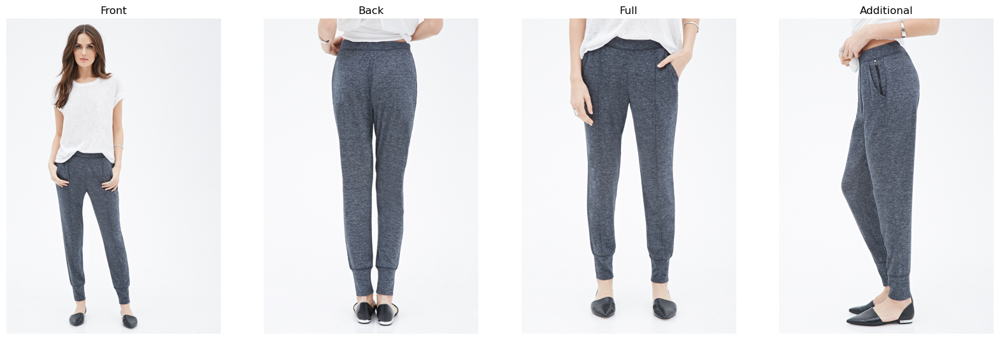


0: 640x448 1 short sleeve dress, 68.0ms
Speed: 4.0ms preprocess, 68.0ms inference, 15.6ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 165ms/step


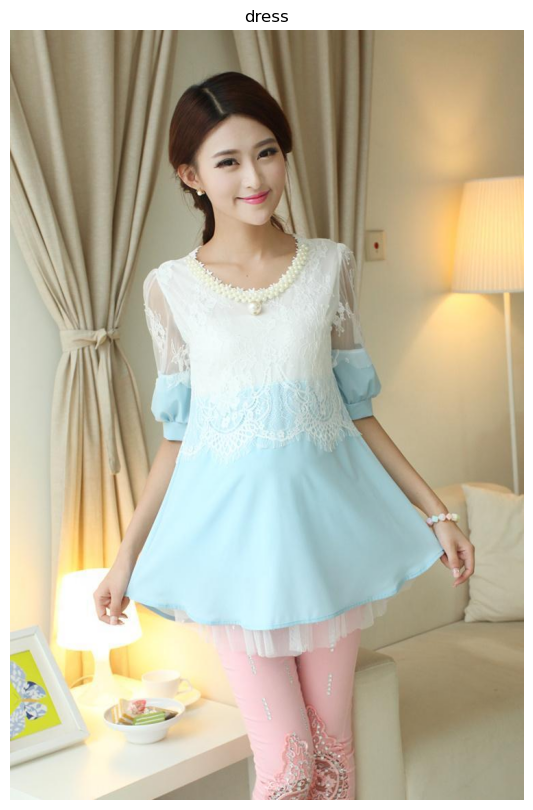


Article - 1


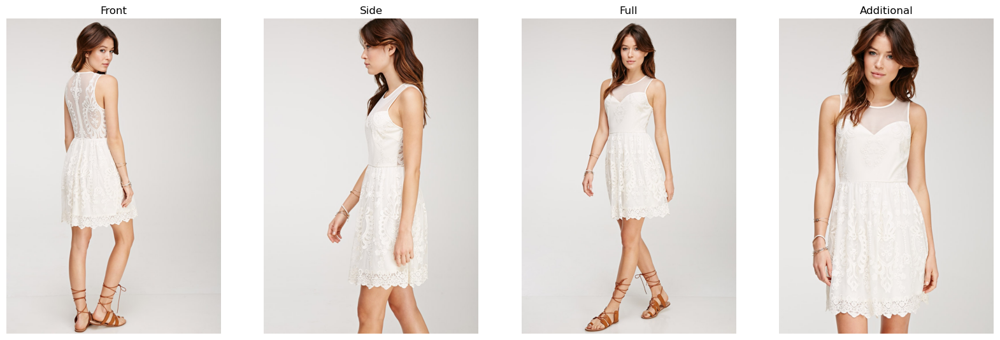


Article - 2


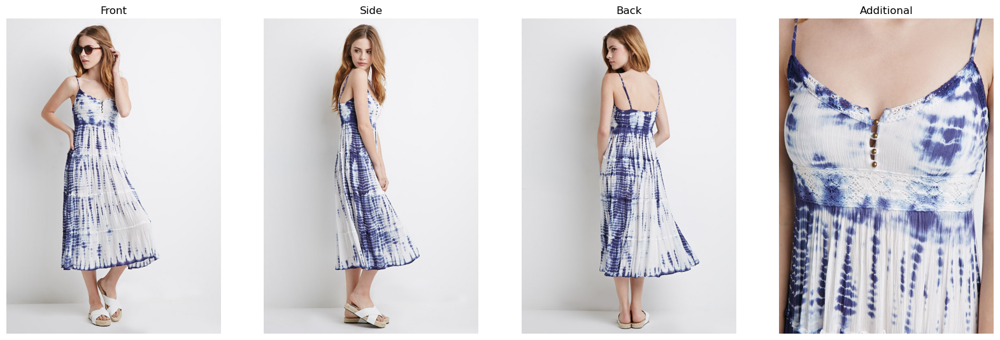


Article - 3


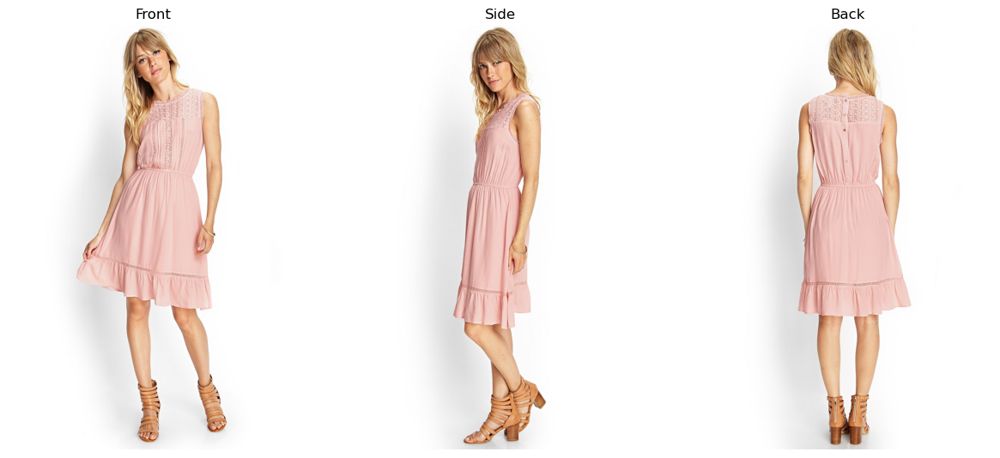


0: 640x384 1 long sleeve top, 1 trousers, 74.3ms
Speed: 4.0ms preprocess, 74.3ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 157ms/step


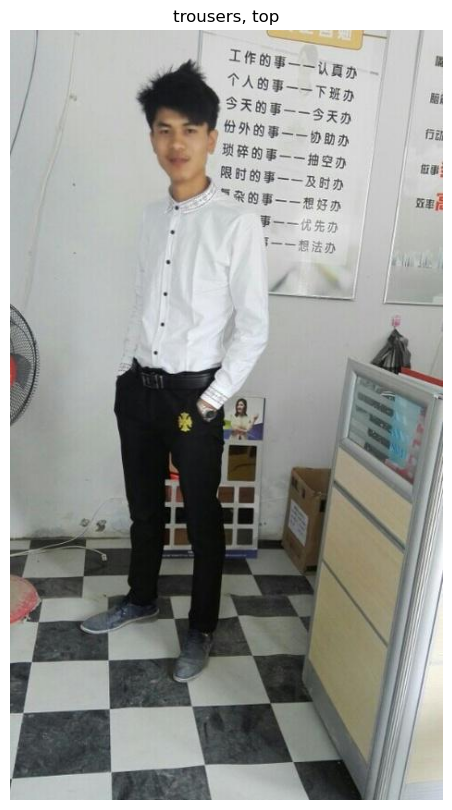


Article - 1


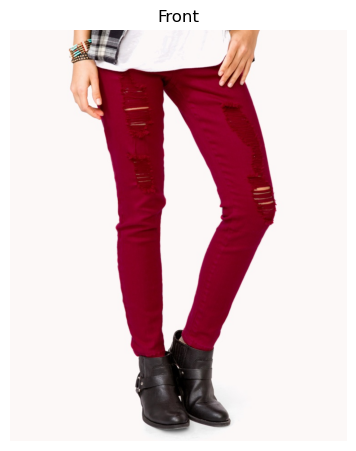


Article - 2


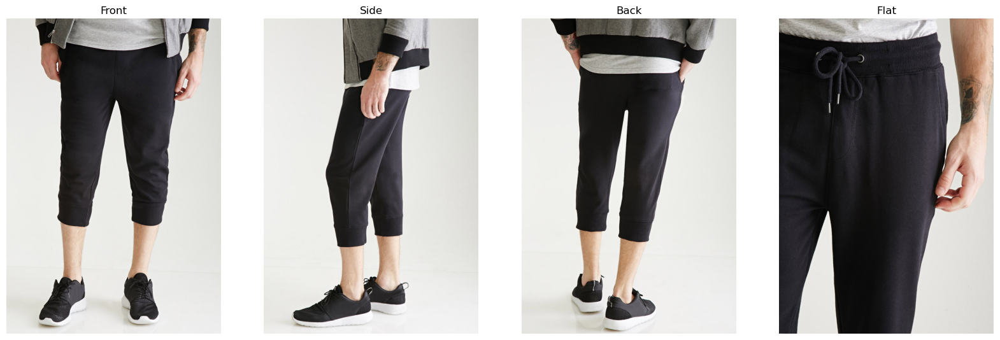


Article - 3


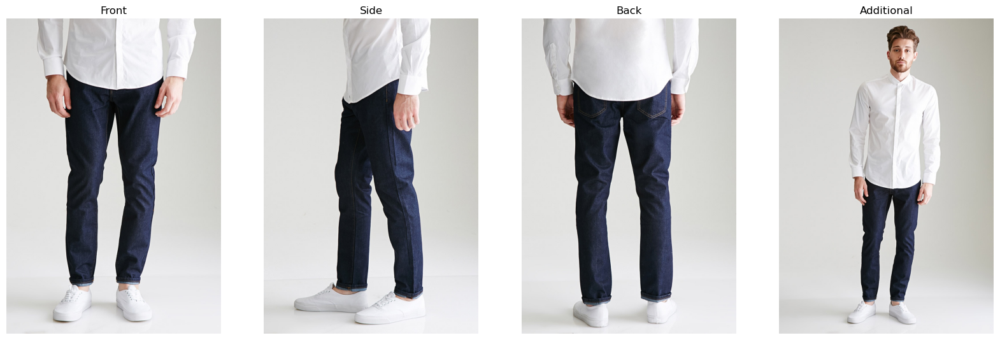


Article - 1


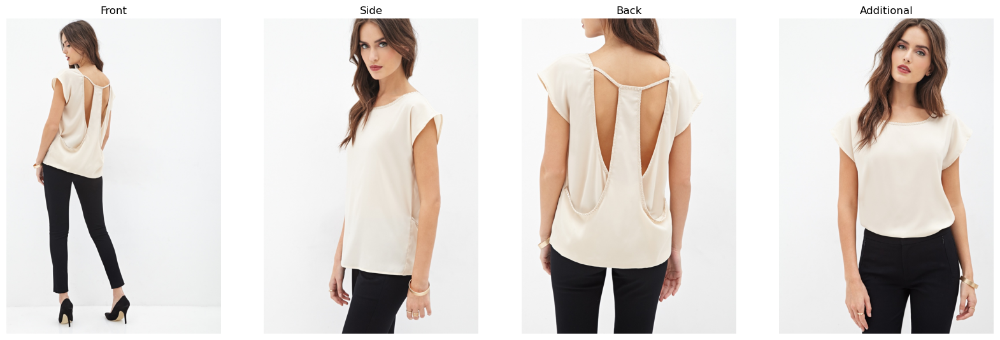


Article - 2


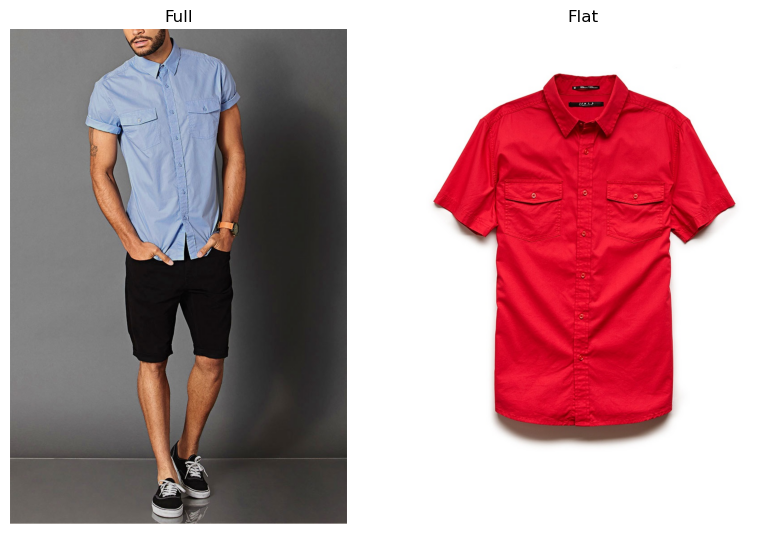


Article - 3


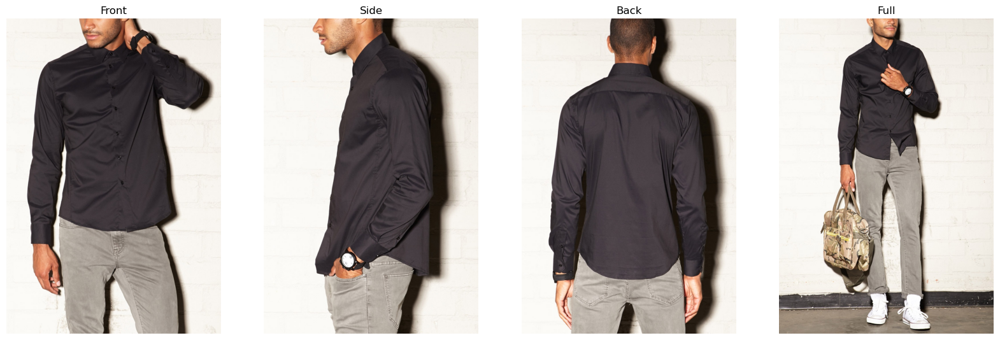


0: 640x448 1 short sleeve top, 1 trousers, 82.9ms
Speed: 0.0ms preprocess, 82.9ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 177ms/step


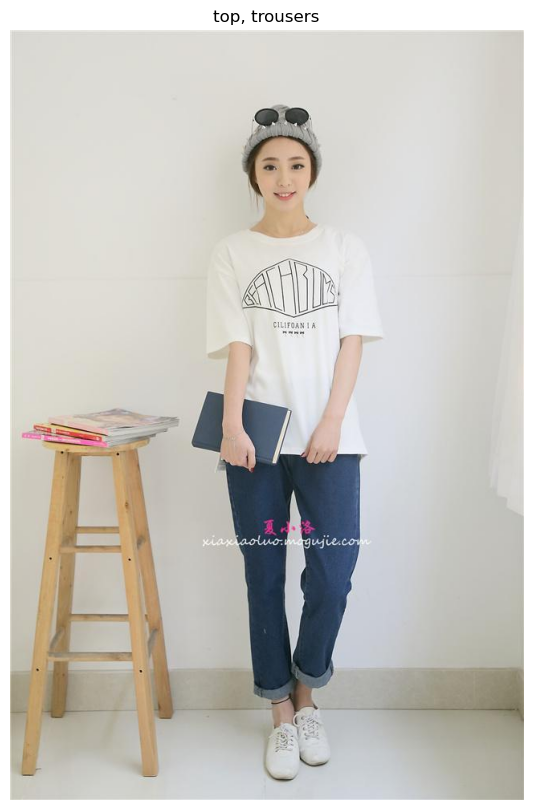


Article - 1


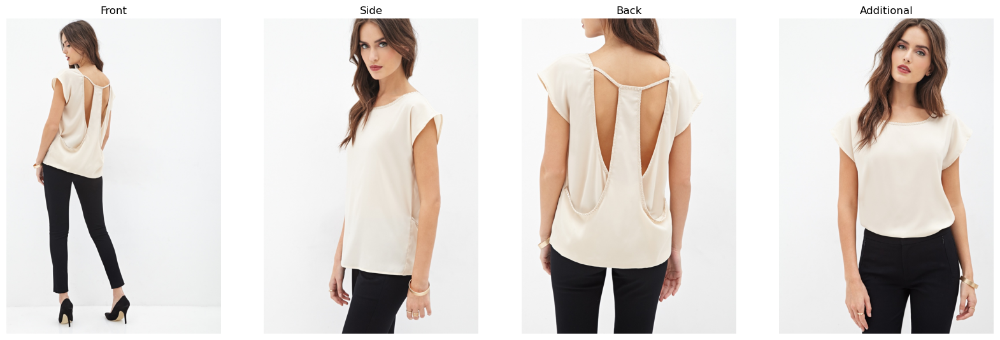


Article - 2


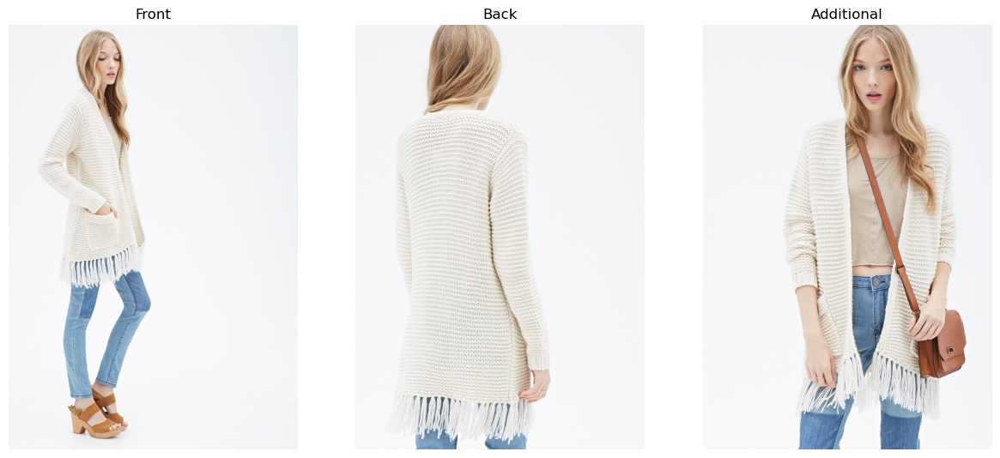


Article - 3


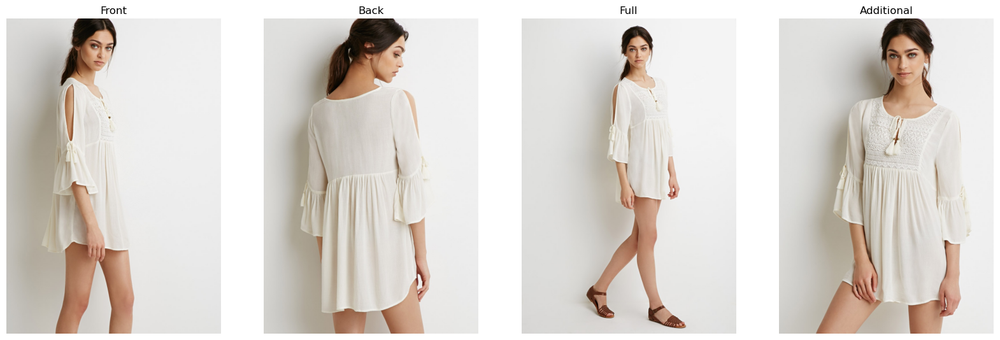


Article - 1


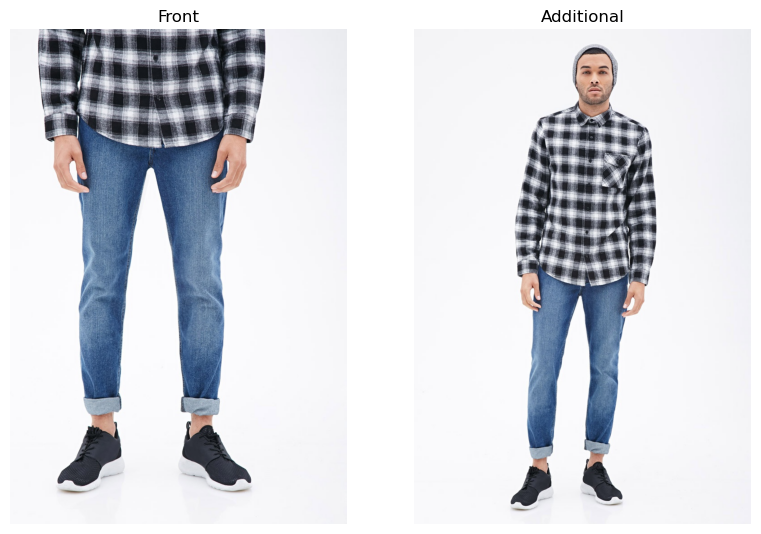


Article - 2


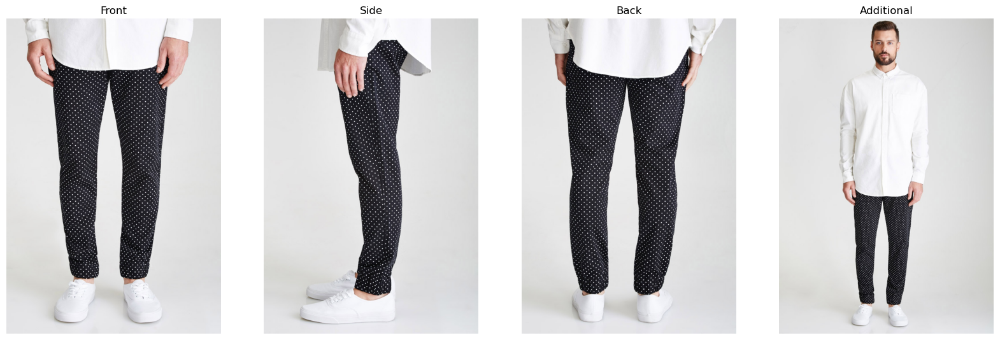


Article - 3


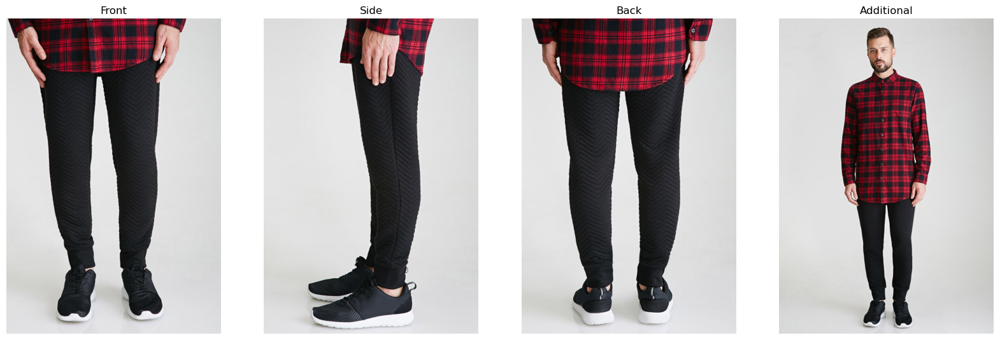


0: 640x448 1 short sleeve top, 1 trousers, 76.8ms
Speed: 5.0ms preprocess, 76.8ms inference, 0.0ms postprocess per image at shape (1, 3, 640, 640)


1/1 [==============================] - 0s 172ms/step


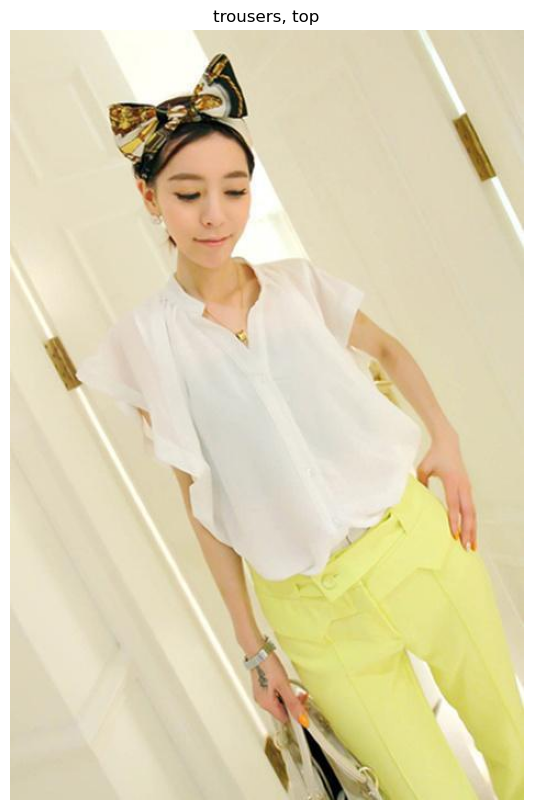


Article - 1


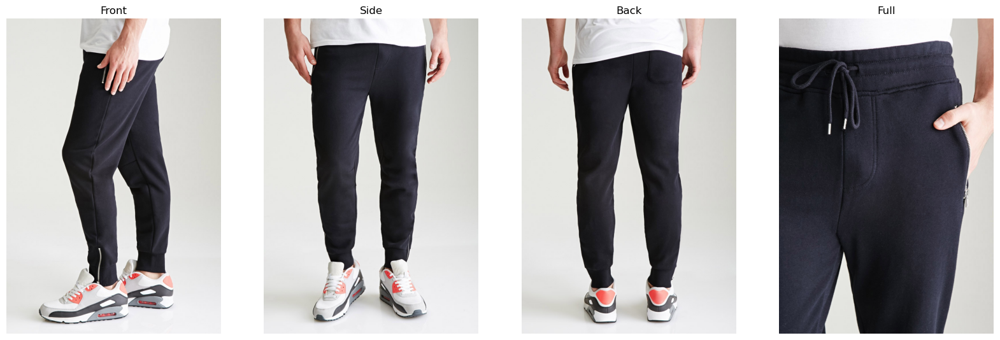


Article - 2


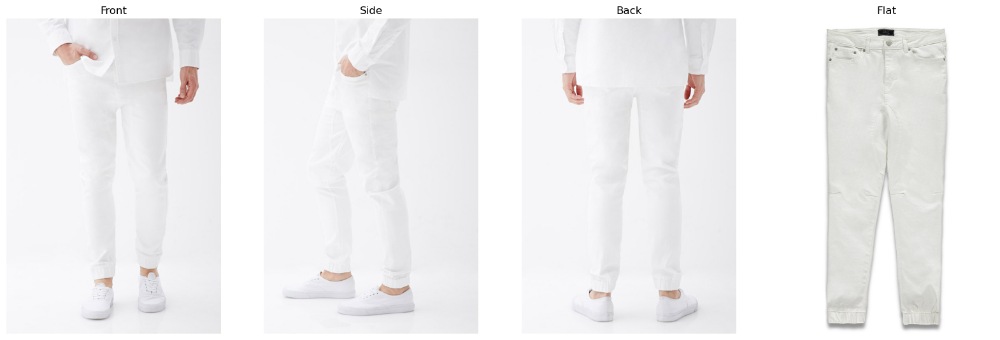


Article - 3


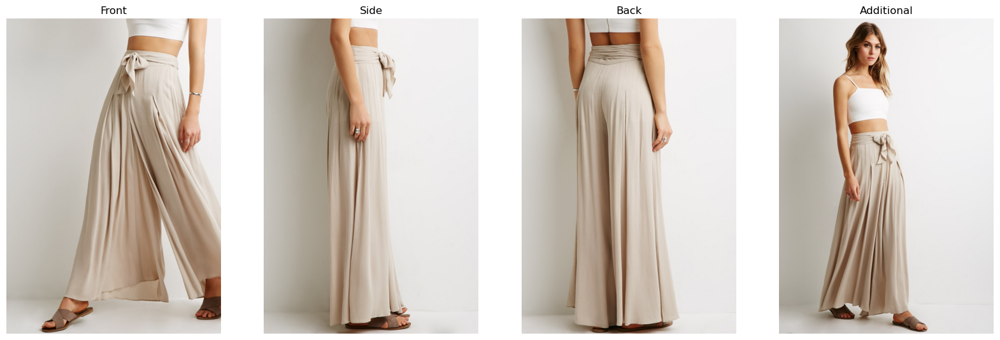


Article - 1


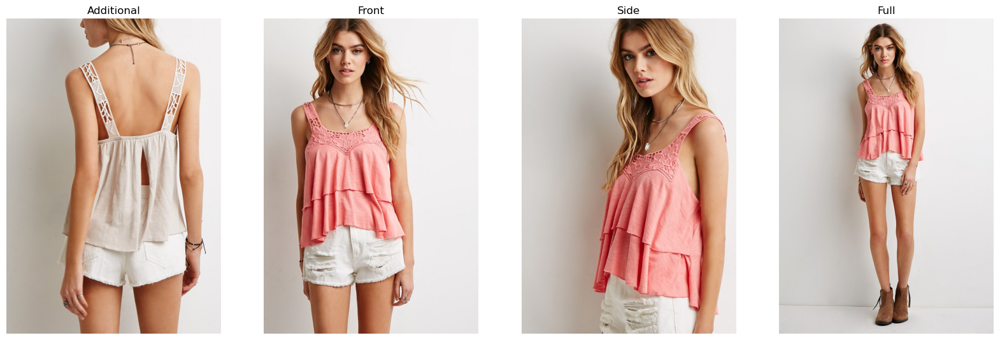


Article - 2


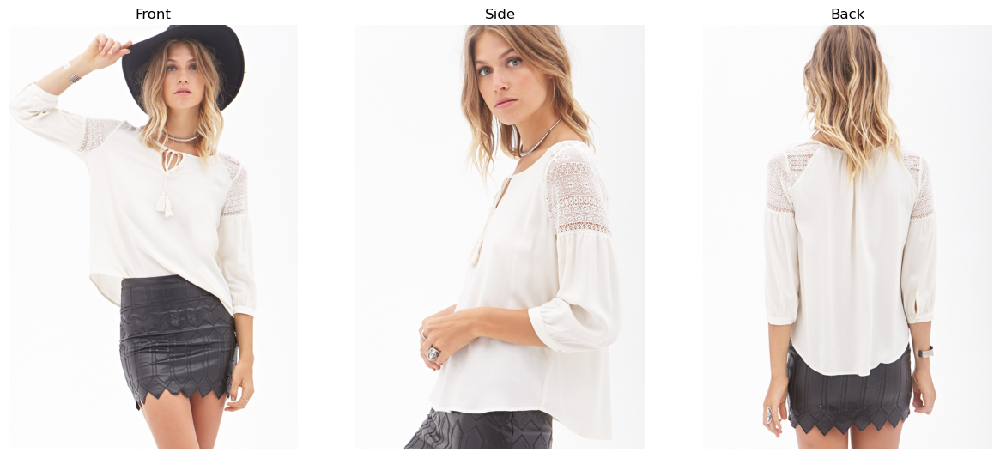


Article - 3


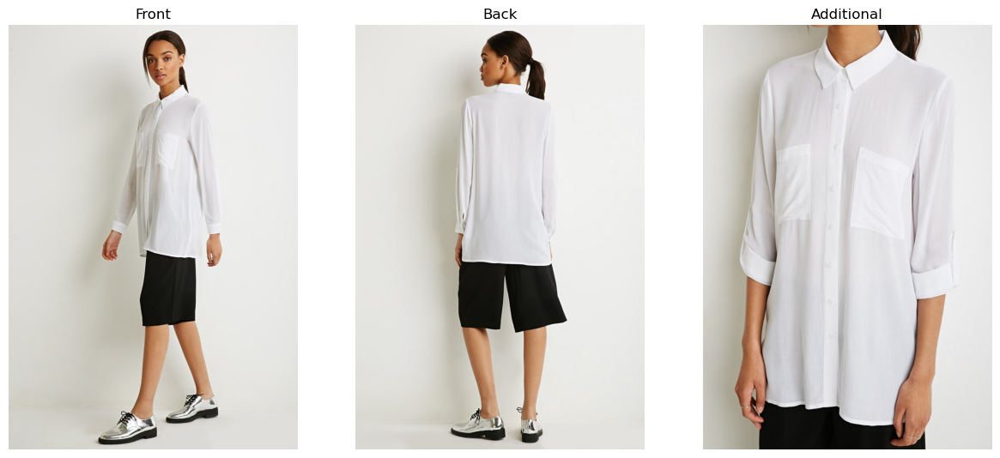

In [16]:
test_images = os.listdir('./data/images/test')
test_images = sample(test_images, 5)

for image in test_images:
    img_path = os.path.join(os.getcwd(), 'data', 'images', 'test', image)
    result = predict(img_path)
    plt.figure(figsize=(10, 10))
    plt.axis('off')
    plt.imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    plt.title(', '.join(result.keys()))
    plt.show()
    if result != None:
        match = recommender(result, no_of_rec=3)
        show_recommendation(match)